# **<center>Investment Prediction</center>**

**Tested Algorithms:**
  1. Linear Rgression
  2. LSTM (Long Short-Term Memory)
  3. GRU (Gated Recurrent Unit)

In [1]:
import pandas as pd
import numpy as np

import datetime
import warnings
warnings.filterwarnings('ignore')

import seaborn as sns
import matplotlib.pylab as plt
from plotly.offline import plot
import chart_studio.plotly as py
import plotly.graph_objects as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

import tensorflow as tf
from tensorflow.keras.models import Sequential
from sklearn.linear_model import LinearRegression
from tensorflow.keras.layers import LSTM, GRU, Dropout, Dense
    
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score, r2_score 
from sklearn.metrics import mean_poisson_deviance, mean_gamma_deviance, accuracy_score

**Data Ingestion**

In [2]:
# Reading all files

rel = r"D:/FSDS-iNeuron/10.Projects-DS/Investment_Prediction/raw_dataset/reliance-industries.csv"

In [3]:
df_pre= pd.read_csv(rel)

In [4]:
df_pre.head()

,Unnamed: 0,Date,Price,Open,High,Low,Volume,Chg%
0,0,"Mar 17, 2023",2223.10,2244.75,2251.95,2212.70,15.70M,-0.13%
1,1,"Mar 16, 2023",2225.90,2243.00,2254.00,2202.20,8.47M,-0.50%
2,2,"Mar 15, 2023",2237.05,2284.10,2298.30,2227.40,10.03M,-1.71%
3,3,"Mar 14, 2023",2275.95,2280.00,2304.95,2269.05,7.40M,-0.37%
4,4,"Mar 13, 2023",2284.50,2329.00,2344.00,2275.00,5.89M,-1.64%


#### Report:
- Here "Close" price data represents as the "Price" column

**Shape of the dataframe**

In [5]:
df_pre.shape

(1733, 8)

### Preprocessing Steps

**Dropping the "Unnamed: 0" column**

In [6]:
df_pre.drop('Unnamed: 0', axis=1, inplace=True)

In [7]:
df_pre.head(2)

,Date,Price,Open,High,Low,Volume,Chg%
0,"Mar 17, 2023",2223.1,2244.75,2251.95,2212.7,15.70M,-0.13%
1,"Mar 16, 2023",2225.9,2243.00,2254.00,2202.2,8.47M,-0.50%


### "Date" column operation

In [8]:
# Basic information about  the dataframe

df_pre.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1733 entries, 0 to 1732
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    1733 non-null   object 
 1   Price   1733 non-null   float64
 2   Open    1733 non-null   float64
 3   High    1733 non-null   float64
 4   Low     1733 non-null   float64
 5   Volume  1733 non-null   object 
 6   Chg%    1733 non-null   object 
dtypes: float64(4), object(3)
memory usage: 94.9+ KB


#### Report:
- Date column is object type and  not in Datetime format
- "Volume" & "Chg%" columns should be in numerical format (int and float)

### Data Wrangling

In [9]:
# Removing the extra characters from Date column

df_pre['Date'] = df_pre['Date'].map(lambda x: str(x).rstrip('E').rstrip('D').rstrip('S'))

In [10]:
# Converting the data type of the column

df_pre['Date'] = pd.to_datetime(df_pre['Date'])

In [11]:
df_pre['Date'].dtype

dtype('<M8[ns]')

In [12]:
df_pre.head(2)

,Date,Price,Open,High,Low,Volume,Chg%
0,2023-03-17,2223.1,2244.75,2251.95,2212.7,15.70M,-0.13%
1,2023-03-16,2225.9,2243.00,2254.00,2202.2,8.47M,-0.50%


**Cheking range of date**

In [13]:
df_pre.iloc[0][0]

Timestamp('2023-03-17 00:00:00')

In [14]:
df_pre.iloc[-1][0]

Timestamp('2016-03-21 00:00:00')

In [15]:
print("Starting date: ", df_pre.iloc[-1][0])
print("Ending date: ", df_pre.iloc[0][0])
print("Duration: ", df_pre.iloc[0][0]-df_pre.iloc[-1][0])

Starting date:  2016-03-21 00:00:00
Ending date:  2023-03-17 00:00:00
Duration:  2552 days 00:00:00


### In the "Volume" column the values are populating in alphanumeric format, let's change it to numerical format, ie., 15.69M --> 15690000

In [16]:
def convert_to_int(value):
    if value.endswith('M'):
        return int(float(value[:-1]) * 1000000)
    elif value.endswith('K'):
        return int(float(value[:-1]) * 1000)
    else:
        return int(value)


values = df_pre['Volume']
df_pre['Volume'] = df_pre['Volume'].apply(convert_to_int)
print(df_pre['Volume'])

0       15700000
1        8470000
2       10030000
3        7400000
4        5890000
          ...   
1728     7320000
1729     8340000
1730     7760000
1731     7080000
1732     5860000
Name: Volume, Length: 1733, dtype: int64


### In the "Chg%" column the values are populating in percentage format, let's change it to numerical format, ie., -0.13% --> -0.0013

In [17]:
def convert_percentage_to_float(value):
    return float(value.replace('%', ''))/100
        
df_pre['Chg%'] = df_pre['Chg%'].apply(convert_percentage_to_float)
print(df_pre['Chg%'])

0      -0.0013
1      -0.0050
2      -0.0171
3      -0.0037
4      -0.0164
         ...  
1728    0.0155
1729   -0.0086
1730   -0.0178
1731    0.0102
1732    0.0098
Name: Chg%, Length: 1733, dtype: float64


#### Making a copy of dataframe

In [18]:
df = df_pre.copy()

#### Making 'Date' column as index 

In [19]:
#df.index = df['Date']  -->> It will keep the date column

df.set_index('Date', inplace= True)

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1733 entries, 2023-03-17 to 2016-03-21
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Price   1733 non-null   float64
 1   Open    1733 non-null   float64
 2   High    1733 non-null   float64
 3   Low     1733 non-null   float64
 4   Volume  1733 non-null   int64  
 5   Chg%    1733 non-null   float64
dtypes: float64(5), int64(1)
memory usage: 94.8 KB


**Top 5 rows of dataframe**

In [21]:
df.head()

,Price,Open,High,Low,Volume,Chg%
Date,,,,,,
2023-03-17,2223.10,2244.75,2251.95,2212.70,15700000,-0.0013
2023-03-16,2225.90,2243.00,2254.00,2202.20,8470000,-0.0050
2023-03-15,2237.05,2284.10,2298.30,2227.40,10030000,-0.0171
2023-03-14,2275.95,2280.00,2304.95,2269.05,7400000,-0.0037
2023-03-13,2284.50,2329.00,2344.00,2275.00,5890000,-0.0164


**Bottom 5 rows of dataframe**

In [22]:
df.tail()

,Price,Open,High,Low,Volume,Chg%
Date,,,,,,
2016-03-29,513.26,507.09,516.11,505.31,7320000,0.0155
2016-03-28,505.41,510.16,511.01,503.06,8340000,-0.0086
2016-03-23,509.77,518.53,518.53,506.40,7760000,-0.0178
2016-03-22,519.01,513.63,521.18,512.96,7080000,0.0102
2016-03-21,513.78,509.15,515.86,506.57,5860000,0.0098


**List of columns in the dataframe**

In [23]:
df.columns

Index(['Price', 'Open', 'High', 'Low', 'Volume', 'Chg%'], dtype='object')

**Checking duplicate values**

In [24]:
df.duplicated().sum()

0

**Checking Null values**

In [25]:
df.isnull().sum()

Price     0
Open      0
High      0
Low       0
Volume    0
Chg%      0
dtype: int64

#### Report:
- We can see that there are no null values, no duplicates found in the data

### Candle Stick Pattern : To Visualize OHLC of a stock

In [26]:
import plotly.graph_objects as go

import pandas as pd
from datetime import datetime

def plot_candle_stick(df):
    fig = go.Figure(data=[go.Candlestick(x=df['Date'],
                    open=df['Open'],
                    high=df['High'],
                    low=df['Low'],
                    close=df['Price'])])

    fig.show()

In [27]:
plot_candle_stick(df_pre)

# Data Analysis : Reliance Inds Data

**Basic statistics of the dataframe**

In [28]:
df.describe()

,Price,Open,High,Low,Volume,Chg%
count,1733.000000,1733.000000,1733.000000,1733.000000,1.733000e+03,1733.000000
mean,1495.395666,1496.688973,1513.355355,1478.942008,9.299105e+06,0.001021
std,722.140994,723.003690,730.500558,714.554771,6.983645e+06,0.018409
min,460.630000,459.670000,465.930000,458.480000,7.312100e+05,-0.131500
25%,905.910000,907.350000,915.220000,898.480000,5.240000e+06,-0.008700
50%,1318.850000,1322.170000,1340.300000,1305.620000,7.240000e+06,0.000500
75%,2181.950000,2185.400000,2215.100000,2157.700000,1.067000e+07,0.010500
max,2819.850000,2856.150000,2856.150000,2786.100000,6.585000e+07,0.147200


**Checking unique values in each column**

In [29]:
df.nunique()

Price     1686
Open      1561
High      1621
Low       1622
Volume    1000
Chg%       615
dtype: int64

#### Checking the correlation

In [30]:
df.corr()

,Price,Open,High,Low,Volume,Chg%
Price,1.000000,0.999319,0.999746,0.999715,0.013878,-0.003226
Open,0.999319,1.000000,0.999673,0.999671,0.011494,-0.032702
High,0.999746,0.999673,1.000000,0.999597,0.021876,-0.016274
Low,0.999715,0.999671,0.999597,1.000000,0.003995,-0.018023
Volume,0.013878,0.011494,0.021876,0.003995,1.000000,0.151541
Chg%,-0.003226,-0.032702,-0.016274,-0.018023,0.151541,1.000000


#### Plotting the heatmap

<AxesSubplot:>

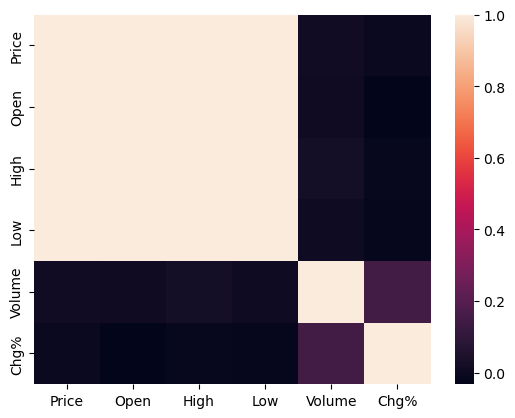

In [31]:
sns.heatmap(df.corr())

### Boxplot -->> To check outliers

<AxesSubplot:>

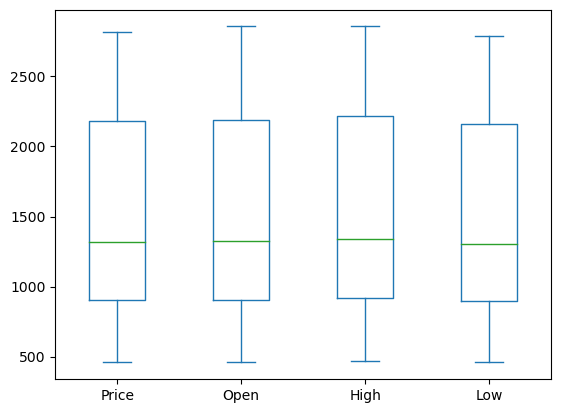

In [32]:
df[['Price', 'Open', 'High', 'Low']].plot(kind='box')

### Line Plot : To visualize stock movement in past years for all data

Text(0.5, 1.0, 'Stock analysis chart')

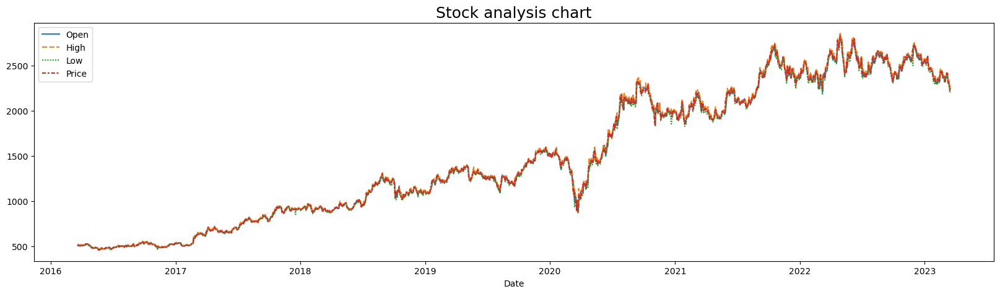

In [33]:
plt.figure(figsize=(20,5))
sns.lineplot(data=df[['Open','High','Low','Price']])
plt.title("Stock analysis chart",fontsize=18)

### To visualize the "Price" column

In [34]:
closedf = df[['Price']]
print("Shape of close dataframe:", closedf.shape)

closedf

Shape of close dataframe: (1733, 1)


,Price
Date,
2023-03-17,2223.10
2023-03-16,2225.90
2023-03-15,2237.05
2023-03-14,2275.95
2023-03-13,2284.50
...,...
2016-03-29,513.26
2016-03-28,505.41
2016-03-23,509.77


In [35]:
closedf = closedf[::-1]
closedf

,Price
Date,
2016-03-21,513.78
2016-03-22,519.01
2016-03-23,509.77
2016-03-28,505.41
2016-03-29,513.26
...,...
2023-03-13,2284.50
2023-03-14,2275.95
2023-03-15,2237.05


In [36]:
# Line plot

def line_plot(df):
    plt.figure(figsize=(20,5))
    sns.lineplot(data=df)
    plt.title("Stock close price chart",fontsize=18)

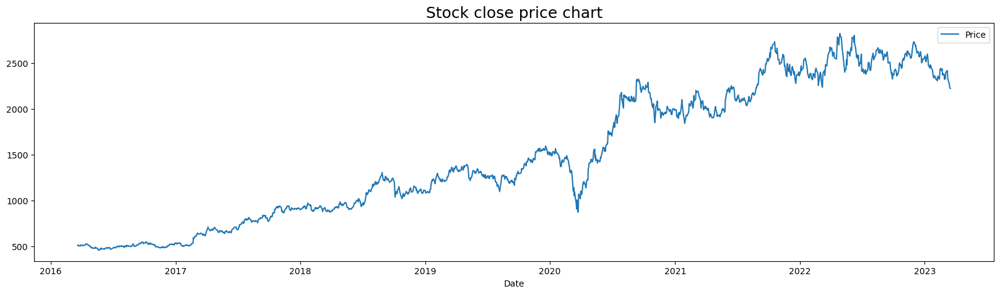

In [37]:
line_plot(closedf)

#### Plotting "Chg%" column

Text(0, 0.5, 'Percenatge returns')

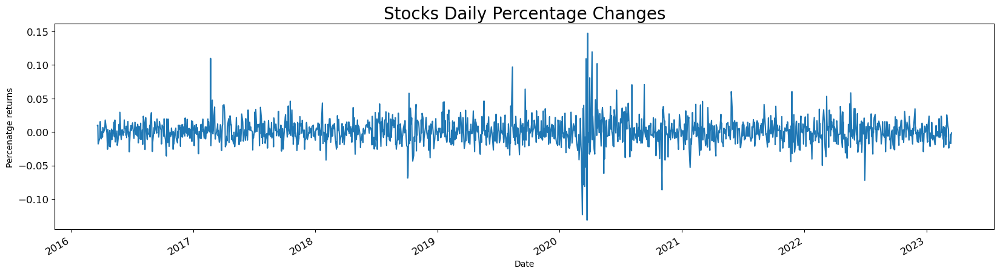

In [38]:
df['Chg%'].plot(figsize = (20, 5), fontsize = 12)
plt.title("Stocks Daily Percentage Changes", fontsize = 20)
plt.xlabel('Date')
plt.ylabel('Percenatge returns')

### Moving averages: 
A moving average is a popular technical analysis tool used to identify trends and potential reversal points in stock prices. You can calculate a moving average by taking the average of the closing prices over a specified period of time. The moving average can be used to smooth out short-term price fluctuations and identify trends. 

### Volatility analysis: 
Volatility is a measure of how much a stock price fluctuates over time. You can calculate volatility by taking the standard deviation of the daily returns. Higher volatility indicates greater uncertainty and risk, while lower volatility indicates more stability. 

In [39]:
# Calculate daily returns and add a new column to the dataframe

df['Return'] = df['Price'].pct_change()

In [40]:
df.head(2)

,Price,Open,High,Low,Volume,Chg%,Return
Date,,,,,,,
2023-03-17,2223.1,2244.75,2251.95,2212.7,15700000,-0.0013,NaN
2023-03-16,2225.9,2243.00,2254.00,2202.2,8470000,-0.0050,0.00126


#### Plot a graph for daily returns over the priods of 13 years

Text(0, 0.5, 'Returns')

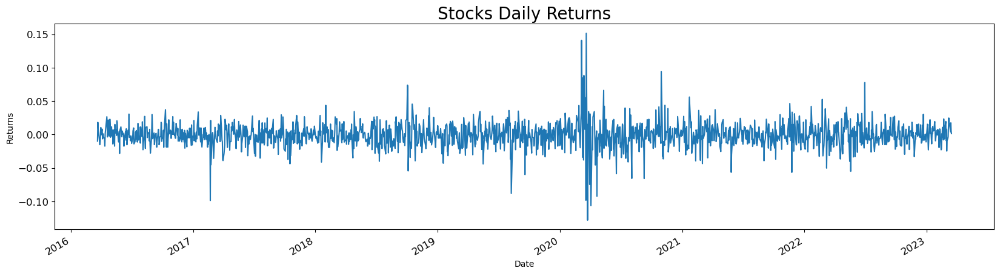

In [41]:
df['Return'].plot(figsize = (20, 5), fontsize = 12)
plt.title("Stocks Daily Returns", fontsize = 20)
plt.xlabel('Date')
plt.ylabel('Returns')

### Moving average

In [42]:
def plot_ma_20(df):
    # Calculate 20-day moving average and add a new column to the dataframe

    df['MA20'] = df['Price'].rolling(window=20).mean()

    # Plot the stock price and its 20-day moving average

    plt.figure(figsize=(10,5))
    plt.plot(df.index, df['Price'], label='Price')
    plt.plot(df.index, df['MA20'], label='20-day MA')
    plt.legend()
    plt.title('Stock Price and its 20-day Moving Average')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.show()

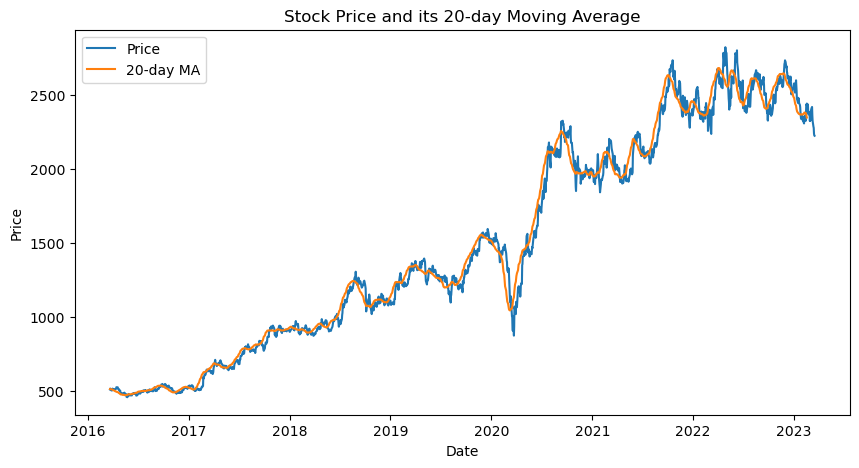

In [43]:
plot_ma_20(df)

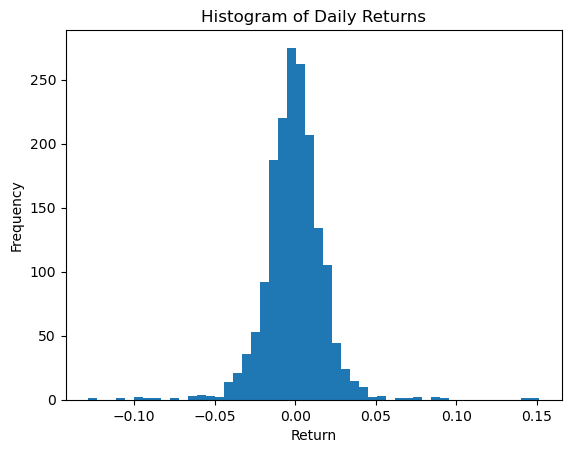

In [44]:
# Plot a histogram of daily returns
plt.hist(df['Return'].dropna(), bins=50)
plt.title('Histogram of Daily Returns')
plt.xlabel('Return')
plt.ylabel('Frequency')
plt.show()

In [45]:
# Calculate cumulative returns

df['Cumulative Returns'] = (1 + df['Return']).cumprod() - 1
print(df.head())

              Price     Open     High      Low    Volume    Chg%    Return  \
Date                                                                         
2023-03-17  2223.10  2244.75  2251.95  2212.70  15700000 -0.0013       NaN   
2023-03-16  2225.90  2243.00  2254.00  2202.20   8470000 -0.0050  0.001260   
2023-03-15  2237.05  2284.10  2298.30  2227.40  10030000 -0.0171  0.005009   
2023-03-14  2275.95  2280.00  2304.95  2269.05   7400000 -0.0037  0.017389   
2023-03-13  2284.50  2329.00  2344.00  2275.00   5890000 -0.0164  0.003757   

            MA20  Cumulative Returns  
Date                                  
2023-03-17   NaN                 NaN  
2023-03-16   NaN            0.001260  
2023-03-15   NaN            0.006275  
2023-03-14   NaN            0.023773  
2023-03-13   NaN            0.027619  


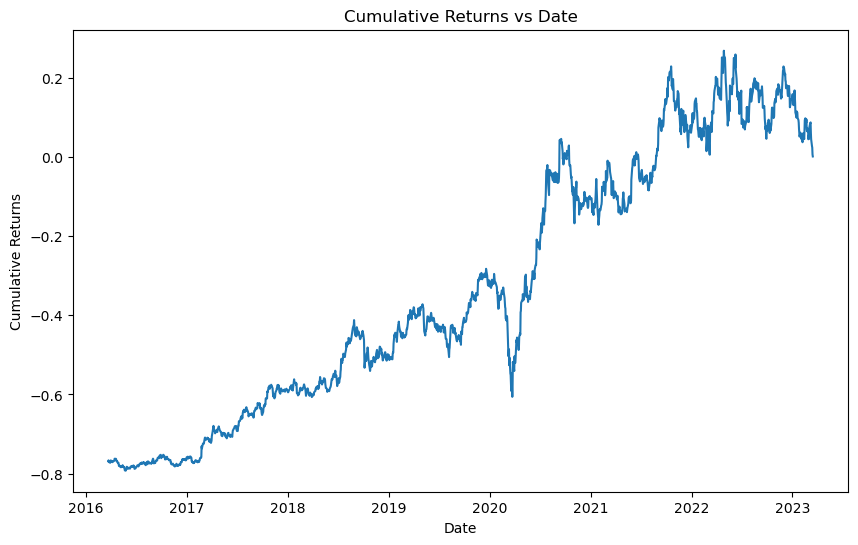

In [46]:
# Plot the cumulative returns

plt.figure(figsize=(10,6))
plt.plot(df['Cumulative Returns'])
plt.xlabel('Date')
plt.ylabel('Cumulative Returns')
plt.title('Cumulative Returns vs Date')
plt.show()

#### Last 30 days data

In [47]:
df.head(30)

,Price,Open,High,Low,Volume,Chg%,Return,MA20,Cumulative Returns
Date,,,,,,,,,
2023-03-17,2223.10,2244.75,2251.95,2212.70,15700000,-0.0013,NaN,NaN,NaN
2023-03-16,2225.90,2243.00,2254.00,2202.20,8470000,-0.0050,0.001260,NaN,0.001260
2023-03-15,2237.05,2284.10,2298.30,2227.40,10030000,-0.0171,0.005009,NaN,0.006275
2023-03-14,2275.95,2280.00,2304.95,2269.05,7400000,-0.0037,0.017389,NaN,0.023773
2023-03-13,2284.50,2329.00,2344.00,2275.00,5890000,-0.0164,0.003757,NaN,0.027619
2023-03-10,2322.70,2341.50,2344.00,2315.05,6150000,-0.0155,0.016721,NaN,0.044802
2023-03-09,2359.25,2416.00,2416.90,2355.10,7490000,-0.0240,0.015736,NaN,0.061243
2023-03-08,2417.35,2408.70,2419.00,2385.00,7280000,0.0036,0.024626,NaN,0.087378
2023-03-06,2408.70,2400.00,2424.60,2400.00,4690000,0.0098,-0.003578,NaN,0.083487


### Rolling Window Analysis: 
We can use rolling windows to calculate statistics over a sliding time period. This can be useful for analyzing trends in stock data over time.

In [48]:
def plot_ma_30(df):
    # Compute the rolling mean
    rolling_mean = df['Price'].rolling(window=30).mean()

    # Plot the rolling mean
    plt.figure(figsize=(10,6))
    plt.plot(df.index, df['Price'], label='Price')
    plt.plot(df.index, rolling_mean, label='30-day Rolling Mean')
    plt.legend()
    plt.show()

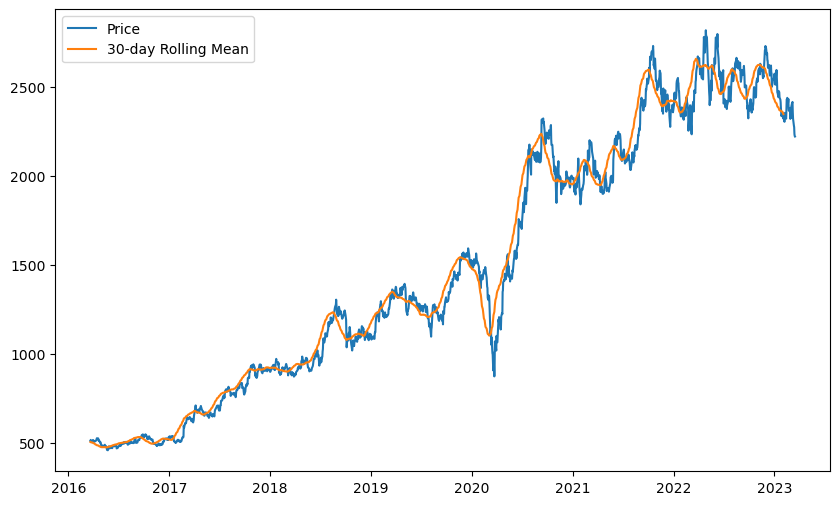

In [49]:
plot_ma_30(df)

### Volume Chart 

In [50]:
def plot_volume(df):
    top_plt = plt.subplot2grid((5,4), (0, 0), rowspan=3, colspan=4)
    top_plt.plot(df.index, df["Price"])
    plt.title('Historical stock prices of Reliance Inds. [01-04-2016 to 30-09-2020]')
    bottom_plt = plt.subplot2grid((5,4), (3,0), rowspan=1, colspan=4)
    bottom_plt.bar(df.index, df['Volume'])
    plt.title('\nReliance Inds. Trading Volume', y=-0.60)
    plt.gcf().set_size_inches(12,8)

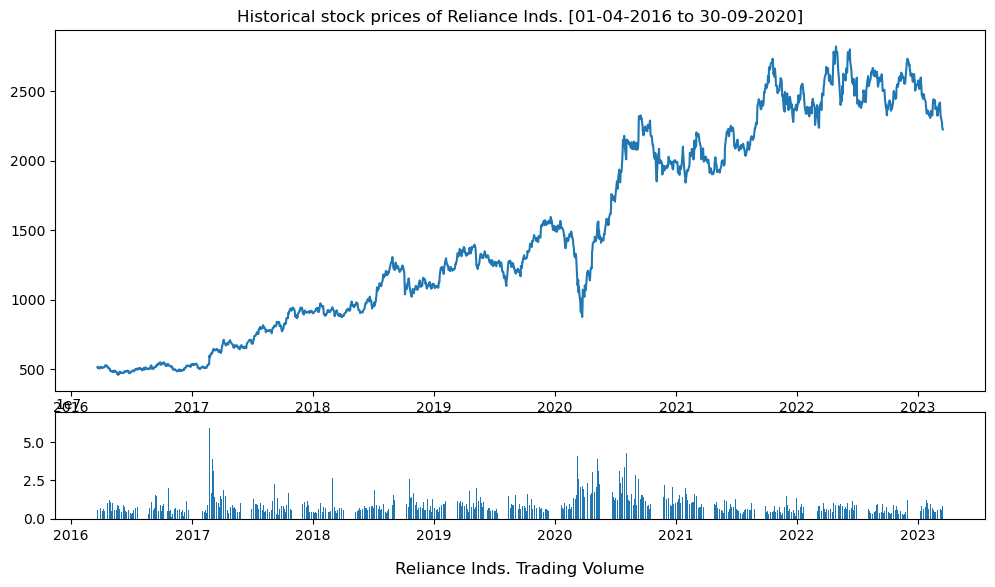

In [51]:
plot_volume(df)

1. Confirming trends: If the volume is increasing as the stock price rises, it confirms the trend. Conversely, if the volume decreases as the stock price rises, it may indicate a lack of interest in the stock and a potential trend reversal.
2. Spotting Breakouts: High volume spikes can signal a potential breakout or a significant change in trend.
3. Identifying accumulation and distribution: Volume can be used to identify whether the market is accumulating or distributing a security. If the volume is increasing while the stock price is falling, it may indicate that the market is accumulating the stock, while if the volume is decreasing while the stock price is falling, it may indicate that the market is distributing the stock.
4. Divergences: Divergences between the stock price and volume can signal potential trend reversals. For example, if the stock price is making new highs but volume is decreasing, it may indicate that the trend is losing momentum.

### 50 MA

In [52]:
# Moving Average Chart

def plot_ma_50(df):
    plt.figure(figsize=(15,5))
    df['50-day MA'] = df['Price'].rolling(window=50).mean()
    plt.plot(df['Price'], label='Price')
    plt.plot(df['50-day MA'], label='50-day MA')
    plt.title("Moving Average Chart forReliance Stock")
    plt.xlabel("Date")
    plt.ylabel("Price")
    plt.legend()
    plt.show()

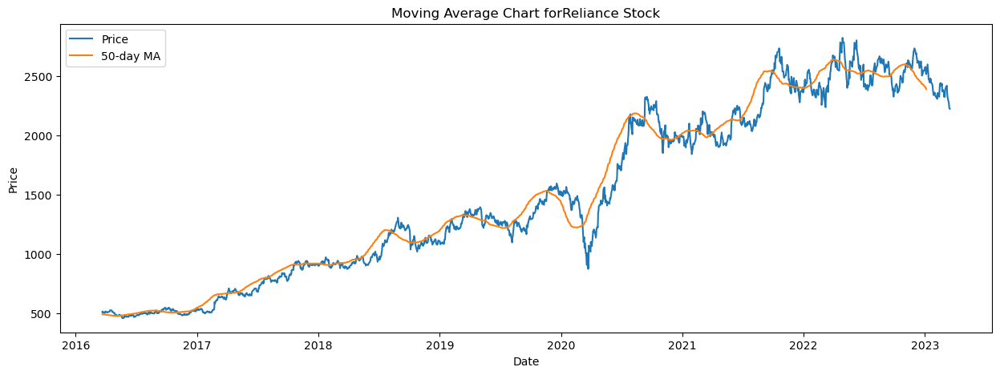

In [53]:
plot_ma_50(df)

### Bollinger Band
**The Bollinger Bands are a useful tool for analyzing a stock's price action, as they can provide valuable insights into the stock's volatility and trend. For example:**
1. When the stock price is near the upper band, it can indicate that the stock is overbought, and the price may be due for a correction.
2. When the stock price is near the lower band, it can indicate that the stock is oversold, and the price may be due for a bounce.
3. If the stock price moves away from the moving average and stays outside of the Bollinger Bands for an extended period of time, it can indicate a strong trend in either direction.
4. If the stock price moves within the Bollinger Bands and bounces back and forth, it can indicate that the stock is consolidating and may be building up energy for a future move.

**The formula for Bollinger Bands is as follows:**

**Middle Band** = Simple Moving Average (SMA) of the stock price over a certain number of periods (usually 20 periods).

**Upper Band** = Middle Band + (2 * Standard Deviation of the stock price over the same number of periods).

**Lower Band** = Middle Band - (2 * Standard Deviation of the stock price over the same number of periods).

Where the standard deviation is a statistical measure of the deviation of the stock price from the average.

In [54]:
# Bollinger Bands Chart

def plot_bollinger_band(df):
    plt.figure(figsize=(15,5))
    df['MA'] = df['Price'].rolling(window=20).mean()
    df['STD'] = df['Price'].rolling(window=20).std()
    df['Upper Band'] = df['MA'] + 2*df['STD']
    df['Lower Band'] = df['MA'] - 2*df['STD']
    plt.plot(df['Price'], label='Price')
    plt.plot(df['Upper Band'], label='Upper Band', linestyle='--')
    plt.plot(df['Lower Band'], label='Lower Band', linestyle='--')
    plt.title("Bollinger Bands Chart for Reliance Stock")
    plt.xlabel("Date")
    plt.ylabel("Price")
    plt.legend()
    plt.show()

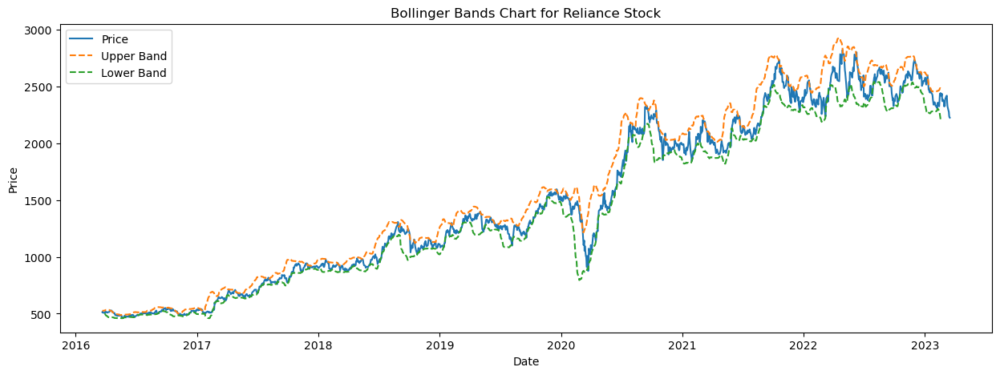

In [55]:
plot_bollinger_band(df)

### MACD

In [56]:
def plot_macd(df):
    # Create the MACD line
    fast_period = 12
    slow_period = 26
    signal_period = 9
    df["MACD"] = df['Price'].ewm(span=fast_period, adjust=False).mean() - df['Price'].ewm(span=slow_period, adjust=False).mean()
    df["Signal"] = df["MACD"].ewm(span=signal_period, adjust=False).mean()

    # Plot the MACD chart
    plt.figure(figsize=(16, 8))
    plt.plot(df['Price'], label='Price')
    plt.plot(df["MACD"], label='MACD')
    plt.plot(df["Signal"], label='Signal')
    plt.legend(loc='best')
    plt.title("MACD Chart for Reliance")
    plt.show()

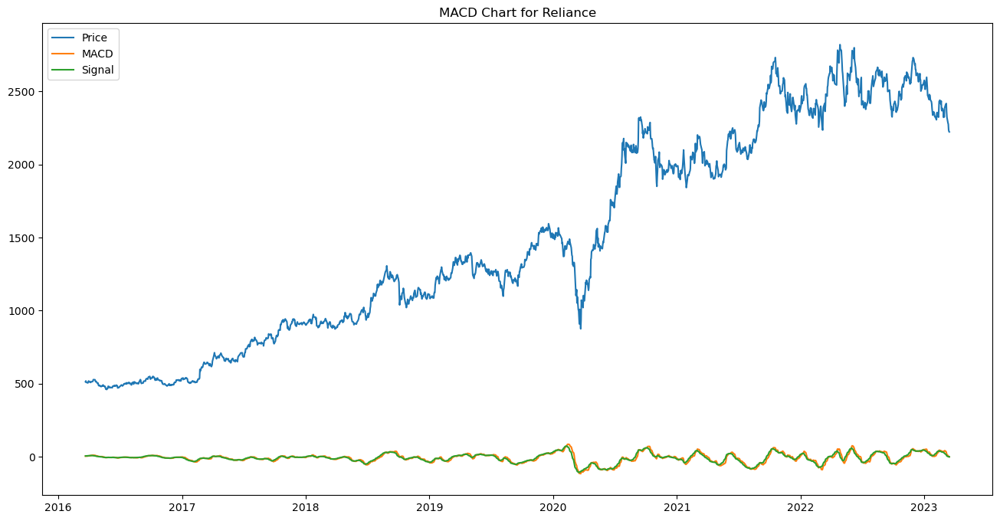

In [57]:
plot_macd(df)

The MACD line crossing above the signal line is generally considered a bullish signal, indicating that the stock's upward momentum is increasing and it may be a good time to buy. Conversely, when the MACD line crosses below the signal line, it is considered a bearish signal, indicating that the stock's downward momentum is increasing and it may be a good time to sell.


The **MACD (Moving Average Convergence Divergence)** formula is calculated as follows:

Calculate the **12-day EMA** of the adjusted close price.

Calculate the **26-day EMA** of the adjusted close price.

Subtract the **26-day EMA** from the 12-day EMA to get the MACD line.

Calculate the **9-day EMA** of the MACD line to get the signal line.

The MACD line and the signal line are then plotted on a chart along with the adjusted close price, creating the MACD chart.

The formula for an exponential moving average (EMA) is:

**EMA(t) = EMA(t-1) + α * (price(t) - EMA(t-1))**

where t is the current time period, α is the smoothing factor (2 / (n+1), where n is the number of periods), and price(t) is the adjusted close price for the current time period.

### 100 SMA

In [58]:
# Moving Average of 100 days

def plot_ma_100(df):
    ma100 = df['Price'].rolling(100).mean()
    plt.figure(figsize=(12,6))
    plt.plot(df['Price'])
    plt.plot(ma100,'r')

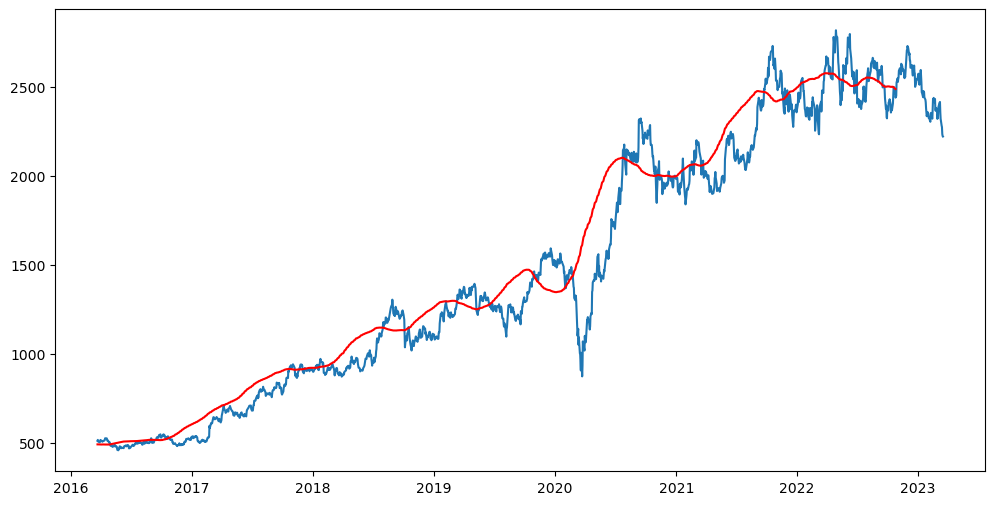

In [59]:
plot_ma_100(df)

### 200 SMA

In [60]:
# Moving average of 200 days

def plot_ma_200(df):
    ma200 = df['Price'].rolling(200).mean()
    plt.figure(figsize=(12,6))
    plt.plot(df['Price'])
    plt.plot(ma200,'g')

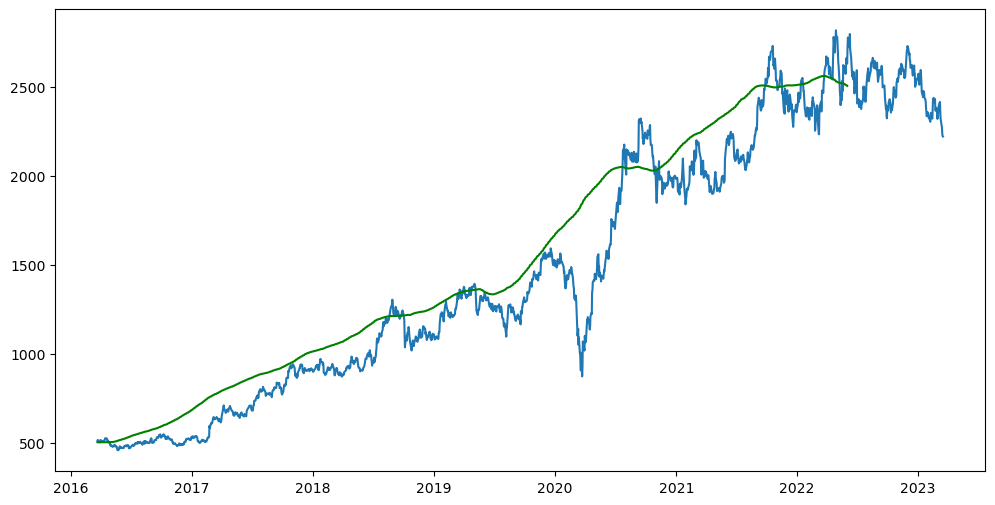

In [61]:
plot_ma_200(df)

### Seasonal Analysis: 
We can use seasonal analysis to determine if there are any recurring patterns in the stock data based on the time of year.

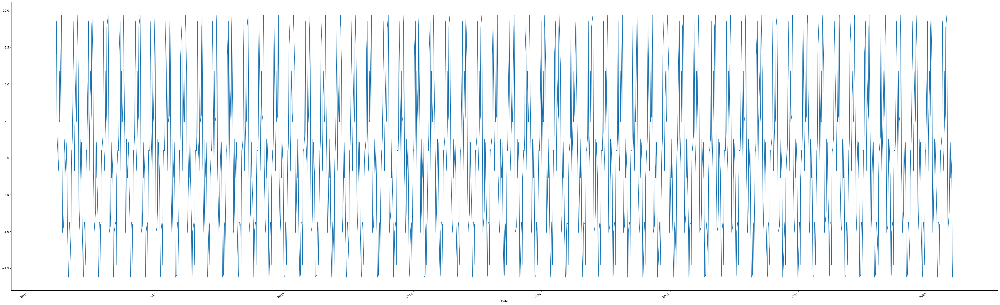

In [62]:
import statsmodels.api as sm

# Decompose the time series into trend, seasonal, and residual components
decomposition = sm.tsa.seasonal_decompose(df['Price'], model='additive', period=30)

# Plot the seasonal component
seasonal = decomposition.seasonal
seasonal.plot(figsize=(60,20))
plt.show()

In [63]:
df

,Price,Open,High,Low,Volume,Chg%,Return,MA20,Cumulative Returns,50-day MA,MA,STD,Upper Band,Lower Band,MACD,Signal
Date,,,,,,,,,,,,,,,,
2023-03-17,2223.10,2244.75,2251.95,2212.70,15700000,-0.0013,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000
2023-03-16,2225.90,2243.00,2254.00,2202.20,8470000,-0.0050,0.001260,NaN,0.001260,NaN,NaN,NaN,NaN,NaN,0.223362,0.044672
2023-03-15,2237.05,2284.10,2298.30,2227.40,10030000,-0.0171,0.005009,NaN,0.006275,NaN,NaN,NaN,NaN,NaN,1.285274,0.292793
2023-03-14,2275.95,2280.00,2304.95,2269.05,7400000,-0.0037,0.017389,NaN,0.023773,NaN,NaN,NaN,NaN,NaN,5.205743,1.275383
2023-03-13,2284.50,2329.00,2344.00,2275.00,5890000,-0.0164,0.003757,NaN,0.027619,NaN,NaN,NaN,NaN,NaN,8.900062,2.800319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-03-29,513.26,507.09,516.11,505.31,7320000,0.0155,-0.010316,513.0910,-0.769124,492.0688,513.0910,7.841296,528.773592,497.408408,6.304818,7.393489
2016-03-28,505.41,510.16,511.01,503.06,8340000,-0.0086,-0.015294,513.6780,-0.772655,492.5566,513.6780,6.661609,527.001219,500.354781,5.193468,6.953484
2016-03-23,509.77,518.53,518.53,506.40,7760000,-0.0178,0.008627,513.9210,-0.770694,493.3006,513.9210,6.408783,526.738565,501.103435,4.611374,6.485062


In [64]:
from pandas_profiling import ProfileReport
#EDA using pandas-profiling
report = ProfileReport(df, explorative=True)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Model Creation

### Evaluation Metrics
**mean squared error:**
* This is a metric that measures the average squared difference between the predicted and actual values. It is calculated as the mean of the squared differences between the predicted and actual values. This metric is useful for penalizing large errors in the predictions, and is commonly used as a loss function during training. However, it can be sensitive to outliers and does not provide an easily interpretable measure of error in the original units of the response variable.

**mean absolute error:** 
* This is a metric that measures the average absolute difference between the predicted and actual values. It is calculated as the mean of the absolute differences between the predicted and actual values. This metric provides an easily interpretable measure of error in the original units of the response variable, and is less sensitive to outliers than the mean squared error.

**explained variance score:** 
* This is a metric that measures the proportion of variance in the target variable that is explained by the model. It is calculated as 1 - (variance of residuals / variance of target variable). This metric provides an indication of how well the model fits the data and can be interpreted as the amount of information captured by the model.

**r2 score:**
* This is a metric that measures the proportion of variance in the target variable that is explained by the model, normalized by the total variance in the target variable. It is calculated as 1 - (sum of squared residuals / total sum of squares). This metric provides a normalized indication of how well the model fits the data, and can be interpreted as the percentage of variance in the target variable that is explained by the model. It ranges from 0 to 1, with 1 indicating a perfect fit and values close to 0 indicating poor performance.

**mean poisson deviance:**
* It is a metric that measures the goodness of fit of a Poisson regression model. It compares the predicted values of the model with the observed values and calculates the mean deviation of the predicted values from the observed values. A lower value of this metric indicates a better fit of the model to the data.

**mean gamma deviance:**
* It is a metric that measures the goodness of fit of a Gamma regression model. It compares the predicted values of the model with the observed values and calculates the mean deviation of the predicted values from the observed values. A lower value of this metric indicates a better fit of the model to the data.

**accuracy score:**
* It is a metric used to evaluate the performance of a classification model. It calculates the proportion of correctly predicted labels to the total number of samples. A higher value of this metric indicates a better classification performance of the model.



In [65]:
def evaluation_train(y_actual, y_predict):
    print('-'*50)
    print("Train data RMSE: ", np.sqrt(mean_squared_error(y_actual,y_predict)))
    print("Train data MSE: ", mean_squared_error(y_actual,y_predict))
    print("Train data MAE: ", mean_absolute_error(y_actual,y_predict))
    print("Train data explained variance regression score:", explained_variance_score(y_actual, y_predict))
    print("Train data R2 score:", r2_score(y_actual, y_predict))
    print('-'*50)
    
def evaluation_test(y_actual, y_predict):
    print('-'*50)
    print("Test data RMSE: ", np.sqrt(mean_squared_error(y_actual,y_predict)))
    print("Test data MSE: ", mean_squared_error(y_actual,y_predict))
    print("Test data MAE: ", mean_absolute_error(y_actual,y_predict))
    print("Test data explained variance regression score:", explained_variance_score(y_actual, y_predict))
    print("Test data R2 score:", r2_score(y_actual, y_predict))   
    print('-'*50)

## Train-Test Split

In [66]:
closedf = df[['Price']]
closedf = closedf[::-1]
closedf

,Price
Date,
2016-03-21,513.78
2016-03-22,519.01
2016-03-23,509.77
2016-03-28,505.41
2016-03-29,513.26
...,...
2023-03-13,2284.50
2023-03-14,2275.95
2023-03-15,2237.05


In [67]:
type(closedf)

pandas.core.frame.DataFrame

In [68]:
closedf.shape

(1733, 1)

In [69]:
# Changing datatype to numpy array to split data

closedf = np.array(closedf).reshape(-1,1)

In [70]:
type(closedf)

numpy.ndarray

In [71]:
closedf.shape

(1733, 1)

In [72]:
training_size=int(len(closedf)*0.8)
test_size=len(closedf)-training_size

train_data,test_data=closedf[0:training_size,:],closedf[training_size:len(closedf),:1]

print("train_data: ", train_data.shape)
print("test_data: ", test_data.shape)

train_data:  (1386, 1)
test_data:  (347, 1)


### Standardizing
**Stock price data are in its raw format can’t be used in an LSTM model directly**

We will use the StandardScaler, rather than the MinMaxScaler, The reason is that stock prices are ever-changing, and there are no true min or max values. It doesn’t make sense to use the MinMaxScaler, although this choice probably won’t lead to disastrous results at the end of the day.


In [73]:
train_data

array([[ 513.78],
       [ 519.01],
       [ 509.77],
       ...,
       [2627.4 ],
       [2601.8 ],
       [2661.05]])

In [74]:
test_data

array([[2627.4 ],
       [2598.6 ],
       [2536.25],
       [2537.8 ],
       [2500.8 ],
       [2483.6 ],
       [2498.85],
       [2501.95],
       [2521.7 ],
       [2549.9 ],
       [2554.55],
       [2593.1 ],
       [2577.8 ],
       [2517.9 ],
       [2464.  ],
       [2473.3 ],
       [2363.75],
       [2385.85],
       [2351.4 ],
       [2492.95],
       [2412.6 ],
       [2441.5 ],
       [2405.4 ],
       [2467.  ],
       [2482.85],
       [2408.25],
       [2362.6 ],
       [2381.85],
       [2418.1 ],
       [2456.45],
       [2458.95],
       [2409.65],
       [2380.15],
       [2373.2 ],
       [2403.9 ],
       [2340.45],
       [2277.35],
       [2311.25],
       [2366.1 ],
       [2365.25],
       [2372.8 ],
       [2370.25],
       [2398.4 ],
       [2402.5 ],
       [2359.1 ],
       [2368.15],
       [2403.85],
       [2458.1 ],
       [2469.6 ],
       [2416.5 ],
       [2436.  ],
       [2438.  ],
       [2455.55],
       [2521.1 ],
       [2535.3 ],
       [25

In [75]:
train_data.shape, test_data.shape

((1386, 1), (347, 1))

In [76]:
# scaler=MinMaxScaler(feature_range=(0,1))

scaler = StandardScaler()

train_data = scaler.fit_transform(np.array(train_data).reshape(-1,1))
test_data = scaler.transform(np.array(test_data).reshape(-1,1))

In [77]:
train_data.shape, test_data.shape

((1386, 1), (347, 1))

In [78]:
# convert an array of values into a dataset matrix
"""
This function creates a sliding window of size time_step over the input dataset and constructs a set of input-output pairs for training a time series forecasting model. 
The input matrix dataX contains n rows, where n is the number of time steps in the input sequence, and time_step columns, representing the past time_step values of the 
input sequence. The output matrix dataY contains n rows and 1 column,representing the next value in the sequence to be predicted.
"""
def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]   ###i=0, 0,1,2,3-----99   100 
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return np.array(dataX), np.array(dataY)

In [79]:
train_data.shape, test_data.shape

((1386, 1), (347, 1))

In [80]:
# reshape into X=t,t+1,t+2,t+3 and Y=t+4

time_step = 1     #60 timestep of X train data and y train label
X_train, y_train = create_dataset(train_data, time_step)    
X_test, y_test = create_dataset(test_data, time_step)

print("X_train: ", X_train.shape)
print("y_train: ", y_train.shape)
print("X_test: ", X_test.shape)
print("y_test", y_test.shape)

X_train:  (1384, 1)
y_train:  (1384,)
X_test:  (345, 1)
y_test (345,)


## Linear Regression

In [81]:
# Creating model

lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

### Predicting output

In [82]:
y_pred_lr_train = lr.predict(X_train)

In [83]:
y_pred_lr_test = lr.predict(X_test)

#### Model evaluation

In [84]:
evaluation_train(y_train, y_pred_lr_train)

--------------------------------------------------
Train data RMSE:  0.04400810306502287
Train data MSE:  0.0019367131353816753
Train data MAE:  0.028401551541224306
Train data explained variance regression score: 0.9980554006469877
Train data R2 score: 0.9980554006469877
--------------------------------------------------


In [85]:
evaluation_test(y_test, y_pred_lr_test)

--------------------------------------------------
Test data RMSE:  0.07113128621636255
Test data MSE:  0.00505965987879409
Test data MAE:  0.05350547658036632
Test data explained variance regression score: 0.8868708071665726
Test data R2 score: 0.8861607660070541
--------------------------------------------------


#### Plotting actual predicted graph : Linear Regression

In [86]:
def plot_actual_vs_predict(y_actual, y_predict):
    plt.plot(y_actual, color='red', label='Actual stock price')
    plt.plot(y_predict, color='green', label='Predicted stock price')
    plt.title('Reliance stock price prediction')
    plt.xlabel('Time')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.show()

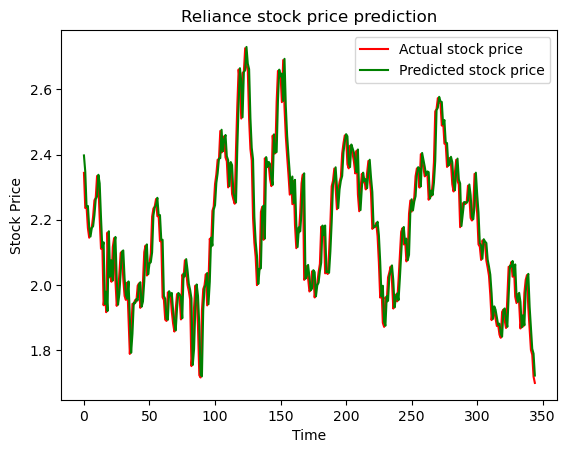

In [87]:
plot_actual_vs_predict(y_test, y_pred_lr_test)

#### Report :
- In linear regression we are getting good accuracy. But we can't use this model for time searies data.
- Because as per **basic assumption** of Linear Regression The error terms should not be dependent on one another. There should be no correlation between the residual terms. The absence of this phenomenon is known as **Autocorrelation**.

# LSTM

### **Long short-term memory (LSTM)**

* LSTM (Long Short-Term Memory) is a deep learning model that is commonly used in the field of natural language processing,time series forecasting, speech recognition, and image classification. It is a type of recurrent neural network (RNN) that is designed to address the vanishing gradient problem, which occurs when RNNs are unable to effectively propagate error gradients over time.

* LSTM has the ability to selectively remember or forget previous inputs based on their relevance to the current output, allowing it to maintain long-term dependencies in sequential data. It consists of a memory cell, an input gate, an output gate, and a forget gate, each of which controls the flow of information within the network.

* The LSTM model has proven to be effective in a variety of applications, including language translation, sentiment analysis, and speech recognition. It has also been used in predictive maintenance, financial forecasting, and other areas that involve time-series data.

* Overall, LSTM is a powerful deep learning model that is well-suited for tasks that involve sequential data and long-term dependencies.

In [88]:
df

,Price,Open,High,Low,Volume,Chg%,Return,MA20,Cumulative Returns,50-day MA,MA,STD,Upper Band,Lower Band,MACD,Signal
Date,,,,,,,,,,,,,,,,
2023-03-17,2223.10,2244.75,2251.95,2212.70,15700000,-0.0013,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000
2023-03-16,2225.90,2243.00,2254.00,2202.20,8470000,-0.0050,0.001260,NaN,0.001260,NaN,NaN,NaN,NaN,NaN,0.223362,0.044672
2023-03-15,2237.05,2284.10,2298.30,2227.40,10030000,-0.0171,0.005009,NaN,0.006275,NaN,NaN,NaN,NaN,NaN,1.285274,0.292793
2023-03-14,2275.95,2280.00,2304.95,2269.05,7400000,-0.0037,0.017389,NaN,0.023773,NaN,NaN,NaN,NaN,NaN,5.205743,1.275383
2023-03-13,2284.50,2329.00,2344.00,2275.00,5890000,-0.0164,0.003757,NaN,0.027619,NaN,NaN,NaN,NaN,NaN,8.900062,2.800319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-03-29,513.26,507.09,516.11,505.31,7320000,0.0155,-0.010316,513.0910,-0.769124,492.0688,513.0910,7.841296,528.773592,497.408408,6.304818,7.393489
2016-03-28,505.41,510.16,511.01,503.06,8340000,-0.0086,-0.015294,513.6780,-0.772655,492.5566,513.6780,6.661609,527.001219,500.354781,5.193468,6.953484
2016-03-23,509.77,518.53,518.53,506.40,7760000,-0.0178,0.008627,513.9210,-0.770694,493.3006,513.9210,6.408783,526.738565,501.103435,4.611374,6.485062


In [89]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1733 entries, 2023-03-17 to 2016-03-21
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Price               1733 non-null   float64
 1   Open                1733 non-null   float64
 2   High                1733 non-null   float64
 3   Low                 1733 non-null   float64
 4   Volume              1733 non-null   int64  
 5   Chg%                1733 non-null   float64
 6   Return              1732 non-null   float64
 7   MA20                1714 non-null   float64
 8   Cumulative Returns  1732 non-null   float64
 9   50-day MA           1684 non-null   float64
 10  MA                  1714 non-null   float64
 11  STD                 1714 non-null   float64
 12  Upper Band          1714 non-null   float64
 13  Lower Band          1714 non-null   float64
 14  MACD                1733 non-null   float64
 15  Signal              1733 non-null   f

### Reshaping data

In [90]:
X_train.shape

(1384, 1)

In [91]:
X_train.shape[0]

1384

In [92]:
# reshape input to be [samples, time steps, features] which is required for LSTM
# LSTM requies 3-dimensional input

X_train =X_train.reshape(X_train.shape[0],X_train.shape[1] , 1)
X_test = X_test.reshape(X_test.shape[0],X_test.shape[1] , 1)

print("X_train: ", X_train.shape)
print("X_test: ", X_test.shape)

X_train:  (1384, 1, 1)
X_test:  (345, 1, 1)


#### **Sequential Model**

* In deep learning, a sequential model is a type of **neural network architecture** in which the layers are arranged sequentially, or one after the other, **with no branching**. This means that the output of each layer is fed as input to the next layer, in a chain-like sequence.

* The sequential model is a popular choice for many deep learning applications, as it is simple and easy to use. However, it may not be appropriate for all types of problems, such as those that require more complex network architectures with multiple inputs or outputs. In those cases, other types of neural network architectures, such as recurrent neural networks or convolutional neural networks, may be more appropriate.

**1.Input shape:** This parameter defines the shape of the input data that is fed to the LSTM network. In Keras, the input shape is specified as a tuple that contains the number of time steps in the sequence and the number of input features in each time step.

**2.Number of hidden units:** This parameter determines the number of hidden units in the LSTM layer. More hidden units generally allow the network to capture more complex patterns in the input data, but also require more computational resources.

**3.Activation function:** This parameter determines the activation function used in the LSTM layer. The most commonly used activation functions in LSTM are the hyperbolic tangent (tanh) function and the sigmoid function. The activation function is used to control the output of the LSTM cell and can help to prevent vanishing or exploding gradients during training.

**4.Dropout:** This parameter is used to prevent overfitting in the LSTM network by randomly dropping out some of the LSTM units during training.

**5.Recurrent dropout:** This parameter is similar to the dropout parameter, but is used to randomly drop out some of the connections between the LSTM cells during training.

**6.Number of time steps:** This parameter determines the number of time steps in the input sequence. In many applications, the number of time steps is fixed, but it can also be variable.

**7.Batch size:** This parameter determines the number of samples in each training batch. A larger batch size can help to speed up training, but can also require more memory.

**8.Learning rate:** This parameter determines the step size used in the optimization algorithm during training. A smaller learning rate can help to prevent overshooting the optimal solution, but can also make the training process slower.

#### Making sequential() model to add layers

In [93]:
lstm_model = Sequential()

lstm_model.add(LSTM(units=100, return_sequences = True, input_shape = (X_train.shape[1], 1)))


lstm_model.add(LSTM(units=100, return_sequences = True))
lstm_model.add(Dropout(0.2))

lstm_model.add(LSTM(units=100, return_sequences = True))
lstm_model.add(Dropout(0.2))

lstm_model.add(LSTM(units=100, return_sequences = False))


lstm_model.add(Dense(units=1))

In [94]:
lstm_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 1, 100)            40800     
                                                                 
 lstm_1 (LSTM)               (None, 1, 100)            80400     
                                                                 
 dropout (Dropout)           (None, 1, 100)            0         
                                                                 
 lstm_2 (LSTM)               (None, 1, 100)            80400     
                                                                 
 dropout_1 (Dropout)         (None, 1, 100)            0         
                                                                 
 lstm_3 (LSTM)               (None, 100)               80400     
                                                                 
 dense (Dense)               (None, 1)                 1

#### Compiling model

In [95]:
lstm_model.compile(optimizer='adam', loss='mean_squared_error')

In [96]:
hist = lstm_model.fit(X_train, y_train, epochs=20, batch_size= 32, verbose=2)

Epoch 1/20
44/44 - 17s - loss: 0.7171 - 17s/epoch - 392ms/step
Epoch 2/20
44/44 - 1s - loss: 0.0328 - 529ms/epoch - 12ms/step
Epoch 3/20
44/44 - 0s - loss: 0.0080 - 469ms/epoch - 11ms/step
Epoch 4/20
44/44 - 1s - loss: 0.0081 - 503ms/epoch - 11ms/step
Epoch 5/20
44/44 - 0s - loss: 0.0077 - 437ms/epoch - 10ms/step
Epoch 6/20
44/44 - 0s - loss: 0.0074 - 428ms/epoch - 10ms/step
Epoch 7/20
44/44 - 0s - loss: 0.0081 - 430ms/epoch - 10ms/step
Epoch 8/20
44/44 - 0s - loss: 0.0084 - 434ms/epoch - 10ms/step
Epoch 9/20
44/44 - 0s - loss: 0.0080 - 433ms/epoch - 10ms/step
Epoch 10/20
44/44 - 0s - loss: 0.0079 - 421ms/epoch - 10ms/step
Epoch 11/20
44/44 - 0s - loss: 0.0081 - 453ms/epoch - 10ms/step
Epoch 12/20
44/44 - 0s - loss: 0.0074 - 412ms/epoch - 9ms/step
Epoch 13/20
44/44 - 0s - loss: 0.0073 - 411ms/epoch - 9ms/step
Epoch 14/20
44/44 - 0s - loss: 0.0076 - 397ms/epoch - 9ms/step
Epoch 15/20
44/44 - 0s - loss: 0.0077 - 401ms/epoch - 9ms/step
Epoch 16/20
44/44 - 1s - loss: 0.0074 - 696ms/epoch -

#### Plotting training loss

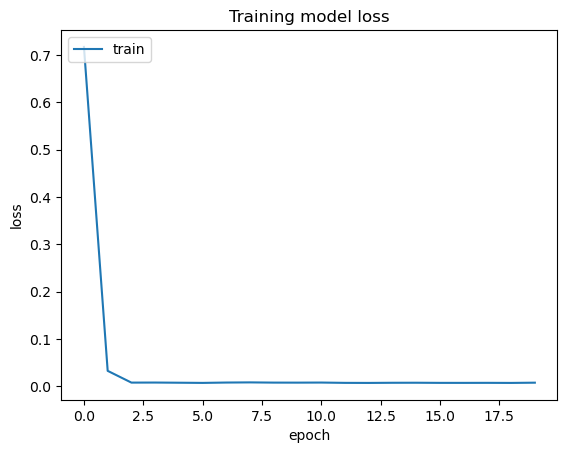

In [97]:
plt.plot(hist.history['loss'])
plt.title('Training model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train'], loc='upper left')
plt.show()

Report :
- Loss decreased

### Validating model with test data

In [98]:
X_test.shape, y_test.shape

((345, 1, 1), (345,))

#### Predicting output

In [99]:
y_pred_lstm_train = lstm_model.predict(X_train)
y_pred_lstm_train

44/44 [==============================] - 3s 5ms/step


array([[-1.2459106],
       [-1.2379355],
       [-1.2520152],
       ...,
       [ 2.3348553],
       [ 2.2386107],
       [ 2.2447886]], dtype=float32)

In [100]:
y_pred_lstm_test = lstm_model.predict(X_test)
y_pred_lstm_test

11/11 [==============================] - 0s 6ms/step


array([[2.2447886],
       [2.2082388],
       [2.1271415],
       [2.12919  ],
       [2.0798342],
       [2.05657  ],
       [2.0772069],
       [2.0813823],
       [2.1078296],
       [2.1451256],
       [2.1512227],
       [2.2011936],
       [2.181484 ],
       [2.102762 ],
       [2.0298123],
       [2.0425415],
       [1.8888819],
       [1.9205297],
       [1.8710552],
       [2.0692418],
       [1.9584001],
       [1.9987725],
       [1.9482541],
       [2.033925 ],
       [2.0555508],
       [1.9522746],
       [1.8872262],
       [1.9148256],
       [1.966127 ],
       [2.0194354],
       [2.0228758],
       [1.9542472],
       [1.9123985],
       [1.9024544],
       [1.9461359],
       [1.8551654],
       [1.7620783],
       [1.8124088],
       [1.8922626],
       [1.8910401],
       [1.901881 ],
       [1.8982238],
       [1.9383566],
       [1.9441576],
       [1.8821818],
       [1.8952087],
       [1.9460652],
       [2.0217066],
       [2.0374842],
       [1.9638811],


#### Model Evaluation

In [101]:
evaluation_train(y_train, y_pred_lstm_train)

--------------------------------------------------
Train data RMSE:  0.05091431401259413
Train data MSE:  0.002592267371373039
Train data MAE:  0.03523372805163695
Train data explained variance regression score: 0.9974521368775906
Train data R2 score: 0.9973971770206363
--------------------------------------------------


In [102]:
evaluation_test(y_test, y_pred_lstm_test)

--------------------------------------------------
Test data RMSE:  0.12534312009776138
Test data MSE:  0.015710897755841835
Test data MAE:  0.10506919227495912
Test data explained variance regression score: 0.8575293720976153
Test data R2 score: 0.6465144676300258
--------------------------------------------------


#### Getting the real data

In [103]:
def get_real_data(y_actual, y_pred):
    predicted_price = scaler.inverse_transform(y_pred)
    actual_price = scaler.inverse_transform(y_actual.reshape(-1,1)) 
    return predicted_price, actual_price

In [104]:
y_actual_lstm, y_pred_lstm = get_real_data(y_test, y_pred_lstm_test)

#### Plotting actual vs Predicted stock price  :  LSTM

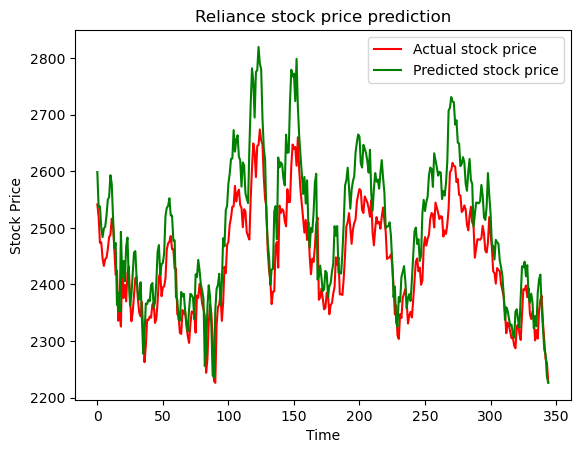

In [105]:
plot_actual_vs_predict(y_actual_lstm, y_pred_lstm)

#### Saving model

In [106]:
# Saving model

lstm_model.save('lstm_model.h5')
lstm_model = tf.keras.models.load_model('lstm_model.h5')

In [107]:
lstm_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 1, 100)            40800     
                                                                 
 lstm_1 (LSTM)               (None, 1, 100)            80400     
                                                                 
 dropout (Dropout)           (None, 1, 100)            0         
                                                                 
 lstm_2 (LSTM)               (None, 1, 100)            80400     
                                                                 
 dropout_1 (Dropout)         (None, 1, 100)            0         
                                                                 
 lstm_3 (LSTM)               (None, 100)               80400     
                                                                 
 dense (Dense)               (None, 1)                 1

### Future Prediction (Using whole data as X)

In [108]:
df_forcast = df[['Price']]
df_forcast = df_forcast[::-1]

In [109]:
closedf

array([[ 513.78],
       [ 519.01],
       [ 509.77],
       ...,
       [2237.05],
       [2225.9 ],
       [2223.1 ]])

In [110]:
type(closedf)

numpy.ndarray

#### Standardizing

In [111]:
data = scaler.transform(closedf)

In [112]:
data.shape

(1733, 1)

#### Creating time step data

In [113]:
def create_time_step_data(data, time_step=1):
    data_np = []
    for i in range(len(data)-time_step-1):
        a = data[i:(i+time_step), 0]
        data_np.append(a)
    return np.array(data_np)

In [114]:
data_np = create_time_step_data(data, 1)

In [115]:
data_np.shape

(1731, 1)

#### Predicting output

In [116]:
y_value = lstm_model.predict(data_np)

55/55 [==============================] - 3s 5ms/step


#### Getting real value

In [117]:
actual, predicted_value = get_real_data(data, y_value)

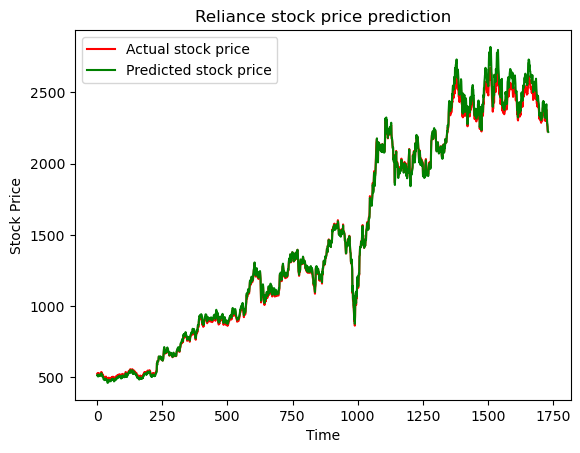

In [118]:
plot_actual_vs_predict(actual, predicted_value)

In [125]:
look_back = 30 #Previous 30 time step

In [126]:
# Prepare data for future prediction
future_data = data[-look_back:]
future_data = np.reshape(future_data, (1, look_back, 1))

In [127]:
num_of_pred_days = 7 # Define num_of_pred_days here

55/55 [==============================] - 1s 8ms/step


ValueError: x and y must have same first dimension, but have shapes (7,) and (1733, 1)

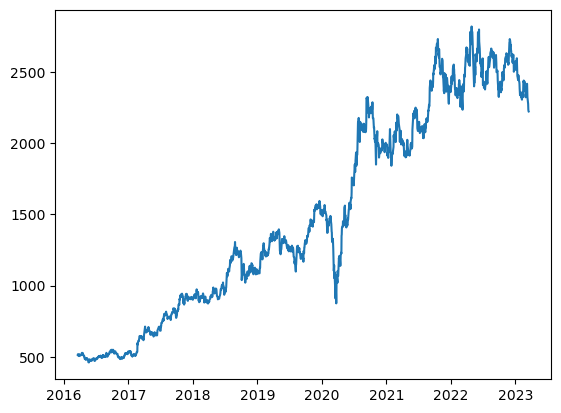

In [128]:
import datetime

# Generate sequence of future dates
last_date = df_forcast.index[-1]
future_dates = pd.date_range(start=last_date, periods=num_of_pred_days+1, freq='D')[1:]

# Predict future stock prices
future_predict = lstm_model.predict(closedf)

# Plot actual and predicted values
plt.plot(df_forcast.index, df_forcast['Price'], label='Actual')
plt.plot(future_dates, future_predict, label='Predicted')
plt.title('Actual vs Predicted values for Future Dates')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()
plt.show()

In [143]:
window_size = 30

1/1 [==============================] - 0s 42ms/step


ValueError: x and y must have same first dimension, but have shapes (7,) and (1, 1)

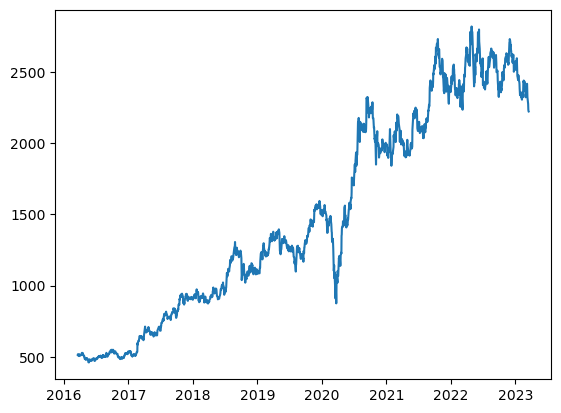

In [142]:
import datetime

# Generate sequence of future dates
last_date = df_forcast.index[-1]
future_dates = pd.date_range(start=last_date, periods=num_of_pred_days+1, freq='D')[1:]

# Standardize future data
future_data = scaler.transform(df_forcast[-window_size:])

# Reshape future data
future_data = np.array(future_data.reshape(1, future_data.shape[0], 1))

# Predict future stock prices
future_predict = lstm_model.predict(future_data)

# Inverse transform predicted prices
future_predict = scaler.inverse_transform(future_predict.reshape(-1,1))

# Plot actual and predicted values
plt.plot(df_forcast.index, df_forcast['Price'], label='Actual')
plt.plot(future_dates, future_predict, label='Predicted')
plt.title('Actual vs Predicted values for Future Dates')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()
plt.show()

In [38]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Load data
data = pd.read_csv('D:/FSDS-iNeuron/10.Projects-DS/Investment_Prediction/pre_processed_dataset/reliance-industries.csv')

# Convert date column to datetime format
data['Date'] = pd.to_datetime(data['Date'])

# Sort data based on date
data.sort_values('Date', inplace=True)

# Set date column as index
data.set_index('Date', inplace=True)

# Split data into train and test sets
train = data.iloc[:int(0.8*len(data)), :]
test = data.iloc[int(0.8*len(data)):, :]

# Normalize data
scaler = MinMaxScaler()
train = scaler.fit_transform(train)
test = scaler.transform(test)

# Create X and y for train and test sets
def create_data(data, window_size):
    X = []
    y = []
    for i in range(window_size, len(data)):
        X.append(data[i-window_size:i, :])
        y.append(data[i, 0])
    X = np.array(X)
    y = np.array(y)
    return X, y

window_size = 60
X_train, y_train = create_data(train, window_size)
X_test, y_test = create_data(test, window_size)

# Define LSTM model
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
model.add(LSTM(units=50))
model.add(Dense(units=1))

# Compile model
model.compile(optimizer='adam', loss='mean_squared_error')

# Fit model to training data
model.fit(X_train, y_train, epochs=100, batch_size=32)

# Predict future prices
future_prices = []
last_x = X_test[-1]
for i in range(30):
    next_price = model.predict(np.array([last_x]))
    future_prices.append(next_price[0][0])
    last_x = np.append(last_x[1:], next_price)[np.newaxis, :]
future_dates = pd.date_range(start=test.index[-1], periods=30, freq='D')

# Inverse transform data
future_prices = scaler.inverse_transform(np.array(future_prices).reshape(-1, 1)).flatten()

# Plot actual and forecasted prices
plt.figure(figsize=(12, 6))
plt.plot(data.index, data['Price'], label='Actual Prices')
plt.plot(future_dates, future_prices, label='Forecasted Prices')
plt.legend()
plt.show()

Epoch 1/100
42/42 [==============================] - 13s 89ms/step - loss: 0.0168
Epoch 2/100
42/42 [==============================] - 4s 93ms/step - loss: 0.0011
Epoch 3/100
42/42 [==============================] - 4s 87ms/step - loss: 8.9427e-04
Epoch 4/100
42/42 [==============================] - 4s 92ms/step - loss: 7.9151e-04
Epoch 5/100
42/42 [==============================] - 4s 92ms/step - loss: 7.0201e-04
Epoch 6/100
42/42 [==============================] - 4s 87ms/step - loss: 6.7431e-04
Epoch 7/100
42/42 [==============================] - 4s 87ms/step - loss: 6.5924e-04
Epoch 8/100
42/42 [==============================] - 4s 88ms/step - loss: 5.5974e-04
Epoch 9/100
42/42 [==============================] - 4s 87ms/step - loss: 5.5582e-04
Epoch 10/100
42/42 [==============================] - 4s 88ms/step - loss: 4.9802e-04
Epoch 11/100
42/42 [==============================] - 5s 108ms/step - loss: 4.8790e-04
Epoch 12/100
42/42 [==============================] - 4s 89ms/step - 

InvalidArgumentError: Graph execution error:

Specified a list with shape [?,6] from a tensor with shape [1,355]
	 [[{{node TensorArrayUnstack/TensorListFromTensor}}]]
	 [[sequential_1/lstm_1/PartitionedCall]] [Op:__inference_predict_function_32222]

In [ ]:
df = pd.read_csv('D:/FSDS-iNeuron/10.Projects-DS/Investment_Prediction/pre_processed_dataset/reliance-industries.csv')
df

## **GRU**
* The GRU (Gated Recurrent Unit) Deep Learning model is a type of artificial neural network that is used for sequence data processing. 
* This model is similar to the LSTM (Long Short-Term Memory) model and is designed to overcome some of the issues associated with LSTM. 
* GRU networks have fewer parameters than LSTM networks, which makes them faster to train and more memory-efficient. 
* The main difference between the two models is that GRU has fewer gates to control the flow of information and therefore, it is less prone to overfitting. 
* The GRU model is widely used in various applications, such as natural language processing, speech recognition, image recognition, and music analysis. 
* It is capable of learning long-term dependencies in the data and can model sequences with arbitrary lengths. In conclusion, the GRU Deep Learning model is a powerful tool for processing sequence data and has proven to be effective in various real-world applications.

In [105]:
X_train.shape, X_test.shape

((1325, 60, 1), (286, 60, 1))

In [106]:
tf.keras.backend.clear_session()
gru_model=Sequential()

gru_model.add(GRU(32,return_sequences=True,input_shape=(time_step,1)))
gru_model.add(Dropout(0.5))

gru_model.add(GRU(32,return_sequences=True))
gru_model.add(Dropout(0.5))

gru_model.add(GRU(32,return_sequences=True))
gru_model.add(Dropout(0.5))

gru_model.add(GRU(32))
gru_model.add(Dropout(0.5))

gru_model.add(Dense(1))
gru_model.compile(loss='mean_squared_error',optimizer='adam')

In [107]:
gru_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 60, 32)            3360      
                                                                 
 dropout (Dropout)           (None, 60, 32)            0         
                                                                 
 gru_1 (GRU)                 (None, 60, 32)            6336      
                                                                 
 dropout_1 (Dropout)         (None, 60, 32)            0         
                                                                 
 gru_2 (GRU)                 (None, 60, 32)            6336      
                                                                 
 dropout_2 (Dropout)         (None, 60, 32)            0         
                                                                 
 gru_3 (GRU)                 (None, 32)                6

In [108]:
gru_model.fit(X_train,y_train,validation_data=(X_test,y_test),epochs=20,batch_size=5,verbose=1)

Epoch 1/20
265/265 [==============================] - 34s 99ms/step - loss: 0.1245 - val_loss: 0.0073
Epoch 2/20
265/265 [==============================] - 22s 81ms/step - loss: 0.0825 - val_loss: 0.1105
Epoch 3/20
265/265 [==============================] - 19s 73ms/step - loss: 0.0666 - val_loss: 0.0148
Epoch 4/20
265/265 [==============================] - 29s 111ms/step - loss: 0.0676 - val_loss: 0.1728
Epoch 5/20
265/265 [==============================] - 22s 84ms/step - loss: 0.0714 - val_loss: 0.0372
Epoch 6/20
265/265 [==============================] - 23s 87ms/step - loss: 0.0660 - val_loss: 0.0452
Epoch 7/20
265/265 [==============================] - 24s 89ms/step - loss: 0.0619 - val_loss: 0.0668
Epoch 8/20
265/265 [==============================] - 21s 81ms/step - loss: 0.0631 - val_loss: 0.0597
Epoch 9/20
265/265 [==============================] - 21s 80ms/step - loss: 0.0561 - val_loss: 0.0739
Epoch 10/20
265/265 [==============================] - 22s 82ms/step - loss: 0.05

In [109]:
### Lets Do the prediction and check performance metrics

y_pred_gru_train = gru_model.predict(X_train)
y_pred_gru_test = gru_model.predict(X_test)

y_pred_gru_train.shape, y_pred_gru_test.shape

9/9 [==============================] - 0s 40ms/step


((1325, 1), (286, 1))

#### Model Evaluation

In [110]:
evaluation_train(y_train, y_pred_gru_train)

--------------------------------------------------
Train data RMSE:  0.09509577218286792
Train data MSE:  0.009043205887055917
Train data MAE:  0.0737673000667822
Train data explained variance regression score: 0.9912542222285216
Train data R2 score: 0.9908163051197002
--------------------------------------------------


In [111]:
evaluation_test(y_test, y_pred_gru_test)

--------------------------------------------------
Test data RMSE:  0.24587114481491879
Test data MSE:  0.06045261985259876
Test data MAE:  0.2416964089589713
Test data explained variance regression score: 0.8115955536911641
Test data R2 score: -4.595546069590476
--------------------------------------------------


#### Inverse Transform

In [112]:
original_ytrain, train_predict = get_real_data(y_train, y_pred_gru_train)
original_ytest, test_predict =  get_real_data(y_test, y_pred_gru_test)

#### Plotting actual vs predicted  : GRU

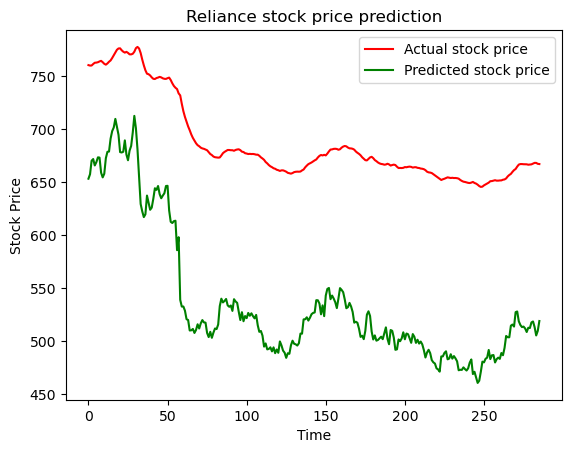

In [113]:
plot_actual_vs_predict(original_ytest, test_predict)

#### Train-Test prediction

In [ ]:
# shift train predictions for plotting

look_back=time_step
trainPredictPlot = np.empty_like(closedf)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
print("Train predicted data: ", trainPredictPlot.shape)

# shift test predictions for plotting
testPredictPlot = np.empty_like(closedf)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(closedf)-1, :] = test_predict
print("Test predicted data: ", testPredictPlot.shape)

plotdf = pd.DataFrame({'Date': df_pre['Date'],'original_close': df_pre['Price'],'train_predicted_close': trainPredictPlot.reshape(1,-1)[0].tolist(),
                       'test_predicted_close': testPredictPlot.reshape(1,-1)[0].tolist()})

plt.figure(figsize=(20,5))
sns.lineplot(data=plotdf)
plt.title("Comparision between original close price vs predicted close price",fontsize=18)

Train predicted data:  (1733, 1)
Test predicted data:  (1733, 1)


In [ ]:
# Saving model

gru_model.save('gru_model.h5')
gru_model = tf.keras.models.load_model('gru_model.h5')

In [ ]:
gru_model.summary()